# EVALUATION

This notebook presents the complete evaluation framework developed for the research article:

*Assessing Place Similarity by Inferring and Modeling Place Semantics from Geosocial Media Data*

It includes the performance evaluation of the h32vec model and the analysis and comparison of topic models trained using text and geotext embeddings. Each section corresponds to one of the core evaluation dimensions discussed in the manuscript.

References to **figures and tables** included in the paper are mentioned explicitly in the corresponding visualizations titles in this notebook.


**Data Availability**

The original geosocial media data used in this study, comprising geotagged posts from  Instagram, Flickr, and X (formerly Twitter), cannot be publicly shared. All data utilized in this study was collected through official APIs or authorized services that, at the time of collection, explicitly prohibited the redistribution of  user-generated content in accordance with their respective terms of service (e.g., the Twitter Developer Agreement and Instagram's API Terms of Use).  While these specific agreements are no longer publicly available due to platform  ownership changes and service restructuring, their restrictions were in effect and adhered to during the data acquisition period.

---
**Notebook Outline**

1. **Data Overview**

2. **Performance evaluation of the h32vec model**

3. **Topic models evaluation**  
   - Load classified Geosocial Media Posts

4. **Evaluation of geographic dispersion**  
   - Visualize the relative entropy for the 4 models  
   - Kruskal-Wallis Test for Comparing Relative Entropy Distributions  
   - Dunn's Post-Hoc Test for Pairwise Comparison of Relative Entropy Distributions

5. **Explore similarity between the topic models**  
   - Explore top 5 topics for each of the models  
   - Visualize topics related to music  
   - Compare high relative entropy topics for the models

6. **Visualize categorized topics for midGeoTextEmb**


**Dependencies**

In [1]:
import os
import pandas as pd
import numpy as np

from sentence_transformers import SentenceTransformer,util
embedding_model = SentenceTransformer("paraphrase-multilingual-MiniLM-L12-v2")
from bertopic import BERTopic
from gensim.models import KeyedVectors

from octis.evaluation_metrics.coherence_metrics import Coherence
from octis.evaluation_metrics.diversity_metrics import TopicDiversity
from octis.evaluation_metrics.similarity_metrics import PairwiseJaccardSimilarity

from scipy.stats import entropy
from scipy.stats import kruskal
import scikit_posthocs as sp

import folium
from folium.plugins import HeatMap
import pandas as pd
import geopandas as gpd
import random
from scipy.stats import sem  # For confidence intervals
import h3 
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from wordcloud import WordCloud
import base64
from io import BytesIO
from IPython.display import display, HTML

import warnings
warnings.filterwarnings("ignore")

/envs/bertopic_env2/lib/python3.11/site-packages/torch/_utils.py:831: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()


In [2]:
folder_path = './'
INPUT = f'{folder_path}/01_Input'
OUTPUT = f'{folder_path}/02_Output'

## 1. Data Overview

**Parse datasets into dataframes**


**Note**: Due to the data-sharing restrictions described above, certain parts of this notebook reference CSV input files that are not included in the repository. Consequently, code cells that load or process these files cannot be executed as-is. 

In [3]:
orig_data = f"{INPUT}/Dresden_GeosocialMedia_Dataset.csv"
preprocessed_data = f"{OUTPUT}/Dresden_GSMDataset_preprocessed.csv"
df_orig = pd.read_csv(orig_data, encoding = 'utf-8-sig')
df_preprocessed = pd.read_csv(preprocessed_data, encoding = 'utf-8-sig')

In [4]:
# Define platform mapping
platform_map = {2: "Flickr", 1: "Instagram", 3: "X (Twitter)"}

# Calculate timeframes from the original dataset
def get_timeframes(df):
    timeframes = {}
    for origin_id, platform in platform_map.items():
        subset = df[df["origin_id"] == origin_id]
        if not subset.empty:
            min_date = pd.to_datetime(subset["post_publish_date"]).min().strftime("%m/%Y")
            max_date = pd.to_datetime(subset["post_publish_date"]).max().strftime("%m/%Y")
            timeframes[platform] = f"{min_date} - {max_date}"
        else:
            timeframes[platform] = "-"
    return timeframes

# Calculate post counts from any dataset
def get_post_counts(df, label):
    counts = {}
    for origin_id, platform in platform_map.items():
        count = len(df[df["origin_id"] == origin_id])
        counts[platform] = f"{count:,}"
    return counts

# Get stats
timeframes = get_timeframes(df_orig)
collected_counts = get_post_counts(df_orig, "Collected GSM posts")
preprocessed_counts = get_post_counts(df_preprocessed, "Preprocessed GSM posts")

# Construct the table
table = {
    "": ["Timeframe", "Collected GSM posts", "Preprocessed GSM posts"],
    "Flickr": [timeframes["Flickr"], collected_counts["Flickr"], preprocessed_counts["Flickr"]],
    "Instagram": [timeframes["Instagram"], collected_counts["Instagram"], preprocessed_counts["Instagram"]],
    "X (Twitter)": [timeframes["X (Twitter)"], collected_counts["X (Twitter)"], preprocessed_counts["X (Twitter)"]],
}

df_table1 = pd.DataFrame(table)

# Display styled table
display(HTML("Table 1. Data overview"))
display(df_table1.style
        .set_table_styles([
            {'selector': 'th', 'props': [('text-align', 'center')]},
            {'selector': 'td', 'props': [('text-align', 'center')]},
        ])
        .set_properties(**{'border': '1px solid black', 'padding': '6px'})
        .hide(axis="index"))


,Flickr,Instagram,X (Twitter)
Timeframe,01/2015 - 06/2022,01/2015 - 07/2018,03/2016 - 12/2022
Collected GSM posts,"58,696","643,106","86,708"
Preprocessed GSM posts,"34,141","456,953","81,561"


## 2. Performance evaluation of the h32vec model

**Load trained h32vec model**

In [5]:
h32vec_model_9 = KeyedVectors.load(f"{OUTPUT}/h32vec_res9.model")

In this step a grid encompasing the administrative area for the city of Dresden will be generated. The grid represent the geospatial data we will test our h32vec model on. 

In [6]:
geojson_path = f'{INPUT}/DD_admin.geojson'

def geojson_to_h3_indices(geojson_path, resolution):
    """
    Converts a GeoJSON polygon or multipolygon to H3 indices.
    """
    # Load the GeoJSON file
    gdf = gpd.read_file(geojson_path)

    # Ensure the GeoJSON is interpreted correctly
    if not gdf.empty and 'geometry' in gdf.columns:
        polygon = gdf.iloc[0].geometry
        if polygon.geom_type != 'Polygon' and polygon.geom_type != 'MultiPolygon':
            raise ValueError(f"Expected a Polygon or MultiPolygon, but got {polygon.geom_type}")
    else:
        raise ValueError("GeoJSON file does not contain valid geometries")

    # Convert the GeoJSON feature into a format that H3 can understand
    geojson = {
        "type": "Polygon",
        "coordinates": [list(polygon.exterior.coords)]
    }

    # Generate H3 indices using the polygon
    h3_indices = h3.polyfill(geojson, resolution, geo_json_conformant=True)
    
    return h3_indices

h3_indices_9 =  geojson_to_h3_indices(geojson_path, 9)
print(f"Generated {len(h3_indices_9)} unique H3 resolution 9 indices")


Generated 3373 unique H3 resolution 9 indices


ERROR 1: PROJ: proj_create_from_database: Open of /envs/bertopic_env2/share/proj failed


In [7]:
test_h3_index = random.choice(list(h3_indices_9))  # Selects a random H3 index from the list
embedding = h32vec_model_9.wv[str(test_h3_index)]
test_h3_index

'891f1b090d7ffff'

**Test top 6 nearest neighbors (r1)**

In [8]:
# Get the closest cells to the specific H3 index
closest_cells = h32vec_model_9.wv.most_similar(test_h3_index, topn=6)

# Initialize a Folium map centered at the centroid of the target cell
target_cell_centroid = h3.h3_to_geo(test_h3_index)
m = folium.Map(location=target_cell_centroid, zoom_start=14)

# Plot the target cell as a red polygon on the map
target_cell_vertices = h3.h3_to_geo_boundary(test_h3_index)
folium.Polygon(locations=target_cell_vertices, color='red', fill=True, fill_color='red', fill_opacity=0.4).add_to(m)

# Plot the closest cells as blue polygons on the map
for cell, _ in closest_cells:
    cell_vertices = h3.h3_to_geo_boundary(cell)
    folium.Polygon(locations=cell_vertices, color='blue', fill=True, fill_color='blue', fill_opacity=0.4).add_to(m)

# Display the map
m

**Test top 18 nearest neighbors (r2)**

In [9]:
# Get the closest cells to the specific H3 index
closest_cells = h32vec_model_9.wv.most_similar(test_h3_index, topn=18)

# Initialize a Folium map centered at the centroid of the target cell
target_cell_centroid = h3.h3_to_geo(test_h3_index)
m = folium.Map(location=target_cell_centroid, zoom_start=14)

# Plot the target cell as a red polygon on the map
target_cell_vertices = h3.h3_to_geo_boundary(test_h3_index)
folium.Polygon(locations=target_cell_vertices, color='red', fill=True, fill_color='red', fill_opacity=0.4).add_to(m)

# Plot the closest cells as blue polygons on the map
for cell, _ in closest_cells:
    cell_vertices = h3.h3_to_geo_boundary(cell)
    folium.Polygon(locations=cell_vertices, color='blue', fill=True, fill_color='blue', fill_opacity=0.4).add_to(m)

# Display the map
m

In [10]:
def get_adaptive_ground_truth(test_cell, topn):
    """
    Dynamically adjusts the ground truth neighborhood based on the number of retrieved neighbors (topn).
    Ensures that r1 and r2 neighbors are correctly separated.
    """
    ground_truth = set()
    ring = 1
    while len(ground_truth) < topn:
        ground_truth.update(h3.k_ring(test_cell, ring))
        ground_truth.discard(test_cell)  # Ensure test cell itself is not included
        ring += 1  # Expand to the next ring if needed
    return ground_truth

def evaluate_h3_embeddings(h3_indices, model, topn=18, runs=50, sample_ratio=0.1):
    """
    Evaluates H3 spatial embeddings using F1-score and precision per ring.
    Compares retrieval consistency with r1 and r2 neighbors.

    Parameters:
    - h3_indices: Set of H3 indexes used for evaluation.
    - model: Trained Word2Vec model containing H3 spatial embeddings.
    - topn: Number of most similar neighbors to retrieve for evaluation.
    - runs: Number of evaluation runs to ensure stable results.
    - sample_ratio: Percentage of embeddings to sample (e.g., 0.1 for 10%).

    Returns:
    - Dictionary containing F1-score, precision per ring, and confidence intervals.
    """

    total_h3_cells = len(h3_indices)
    sample_size = int(sample_ratio * total_h3_cells)  # Sample dynamically

    all_metrics = {
        "F1-score": [],
        "Precision r1": [],
        "Precision r2": [],
        "Random F1-score": [],  # Baseline comparison
    }

    for _ in range(runs):
        test_subset = random.sample(sorted(h3_indices), min(sample_size, total_h3_cells))
        run_metrics = {key: [] for key in all_metrics.keys()}

        for test_cell in test_subset:
            # Get adaptive ground truth neighbors based on topn
            ground_truth = get_adaptive_ground_truth(test_cell, topn)

            try:
                # Retrieve top-N most similar cells
                retrieved_neighbors = [cell for cell, _ in model.wv.most_similar(test_cell, topn=topn)]
            except KeyError:
                continue  # Skip if test cell is not in vocabulary

            # Separate r1 and r2 neighbors correctly
            r1_neighbors = set(h3.k_ring(test_cell, 1)) & ground_truth
            r2_neighbors = (set(h3.k_ring(test_cell, 2)) - set(h3.k_ring(test_cell, 1))) & ground_truth

            # Compute precision for r1 (top 6 neighbors should be r1)
            retrieved_r1 = set(retrieved_neighbors[:6])
            precision_r1 = len(retrieved_r1 & r1_neighbors) / 6 if r1_neighbors else float("nan")

            # Compute precision for r2 (next 12 neighbors should be r2)
            retrieved_r2 = set(retrieved_neighbors[6:18])
            precision_r2 = len(retrieved_r2 & r2_neighbors) / 12 if r2_neighbors else float("nan")

            # Compute TP, FP, FN for normal F1-score
            TP = sum(1 for cell in retrieved_neighbors if cell in ground_truth)
            FP = topn - TP
            FN = len(ground_truth) - TP  # False negatives

            # Compute Precision, Recall, F1-score
            precision = TP / (TP + FP) if (TP + FP) > 0 else 0
            recall = TP / (TP + FN) if (TP + FN) > 0 else 0
            f1_score = 2 * precision * recall / (precision + recall) if (precision + recall) > 0 else 0

            # Compute random baseline F1-score (for comparison)
            random_neighbors = random.sample(sorted(h3_indices), topn)
            random_TP = sum(1 for cell in random_neighbors if cell in ground_truth)
            random_FP = topn - random_TP
            random_FN = len(ground_truth) - random_TP
            random_precision = random_TP / (random_TP + random_FP) if (random_TP + random_FP) > 0 else 0
            random_recall = random_TP / (random_TP + random_FN) if (random_TP + random_FN) > 0 else 0
            random_f1_score = 2 * random_precision * random_recall / (random_precision + random_recall) if (random_precision + random_recall) > 0 else 0

            # Store results for this test cell
            run_metrics["F1-score"].append(f1_score)
            run_metrics["Precision r1"].append(precision_r1)
            run_metrics["Precision r2"].append(precision_r2)
            run_metrics["Random F1-score"].append(random_f1_score)

        # Store per-run averages
        for key in all_metrics.keys():
            all_metrics[key].append(np.nanmean(run_metrics[key]))  # Ignore NaNs for cases with missing ranks

    # Compute final mean and confidence intervals
    final_results = {}
    for key, values in all_metrics.items():
        mean_val = np.nanmean(values)  # Ignore NaNs for missing values
        ci_95 = 1.96 * sem(values, nan_policy="omit") if len(values) > 1 else 0  # Compute CI safely
        final_results[key] = {"Mean": mean_val, "95% CI": (mean_val - ci_95, mean_val + ci_95)}

    return final_results


In [11]:
# Run evaluation
topn_r1 = 6
results_r1 = evaluate_h3_embeddings(h3_indices_9, h32vec_model_9, topn=topn_r1, runs=50, sample_ratio=0.1)

topn_r2 = 18
results_r2 = evaluate_h3_embeddings(h3_indices_9, h32vec_model_9, topn=topn_r2, runs=50, sample_ratio=0.1)

# Construct table rows
rows = []
for label, res in zip(["$r_1$", "$r_1 + r_2$"], [results_r1, results_r2]):
    row = {
        "Neighboring ring": label,
        "F1-score (95% CI)": f"{res['F1-score']['Mean']:.3f} ({res['F1-score']['95% CI'][0]:.3f}–{res['F1-score']['95% CI'][1]:.3f})",
        "Precision $r_1$ (95% CI)": f"{res['Precision r1']['Mean']:.3f} ({res['Precision r1']['95% CI'][0]:.3f}–{res['Precision r1']['95% CI'][1]:.3f})",
        "Precision $r_2$ (95% CI)": "-" if pd.isna(res['Precision r2']['Mean']) else 
                                     f"{res['Precision r2']['Mean']:.3f} ({res['Precision r2']['95% CI'][0]:.3f}–{res['Precision r2']['95% CI'][1]:.3f})",
    }
    rows.append(row)

# Display table
df_eval = pd.DataFrame(rows)
df_eval.style.set_caption("Table 2. Performance results of the Word2Vec model that was trained to learn H3 location embeddings.")


,Neighboring ring,F1-score (95% CI),Precision $r_1$ (95% CI),Precision $r_2$ (95% CI)
0,$r_1$,0.878 (0.876–0.881),0.878 (0.876–0.881),-
1,$r_1 + r_2$,0.840 (0.838–0.842),0.880 (0.878–0.882),0.714 (0.710–0.717)


## 3. Topic models evaluation

**Load the 4 BERTopic models**

In [12]:
models_path = f"{OUTPUT}/Topic_Models/"

topic_model = BERTopic.load(f"{models_path}/TextEmb_Model", embedding_model=embedding_model)
topics = topic_model.topics_
topics_df = topic_model.get_topic_info()

topic_model0 = BERTopic.load(f"{models_path}/lowGeoTextEmb_Model")
topics0= topic_model0.topics_
topics0_df = topic_model0.get_topic_info()

topic_model1 = BERTopic.load(f"{models_path}/midGeoTextEmb_Model")
topics1 = topic_model1.topics_
topics1_df = topic_model1.get_topic_info()

topic_model2 = BERTopic.load(f"{models_path}/highGeoTextEmb_Model")
topics2 = topic_model2.topics_
topics2_df = topic_model2.get_topic_info()


2025-05-21 10:02:20,281 - BERTopic - WARNING: You are loading a BERTopic model without explicitly defining an embedding model. If you want to also load in an embedding model, make sure to use `BERTopic.load(my_model, embedding_model=my_embedding_model)`.
2025-05-21 10:02:20,485 - BERTopic - WARNING: You are loading a BERTopic model without explicitly defining an embedding model. If you want to also load in an embedding model, make sure to use `BERTopic.load(my_model, embedding_model=my_embedding_model)`.
2025-05-21 10:02:20,844 - BERTopic - WARNING: You are loading a BERTopic model without explicitly defining an embedding model. If you want to also load in an embedding model, make sure to use `BERTopic.load(my_model, embedding_model=my_embedding_model)`.


### Load classified Geosocial Media Posts


**Note**: Due to the data-sharing restrictions described above, certain parts of this notebook reference CSV input files that are not included in the repository. Consequently, code cells that load or process these files cannot be executed as-is. 

In [13]:
#read classified gsm posts
file = f'{OUTPUT}/Dresden_GSMDataset_classified.csv'
df = pd.read_csv(file)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 572655 entries, 0 to 572654
Data columns (total 26 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   origin_id    572655 non-null  int64  
 1   post_guid    572655 non-null  object 
 2   latitude     572655 non-null  float64
 3   longitude    572655 non-null  float64
 4   user_guid    572655 non-null  object 
 5   post_date    572655 non-null  object 
 6   post_text    572655 non-null  object 
 7   text         572655 non-null  object 
 8   h3_index_9   572655 non-null  object 
 9   T#_TE        572655 non-null  int64  
 10  TCount_TE    572655 non-null  int64  
 11  TName_TE     572655 non-null  object 
 12  Repre_TE     572655 non-null  object 
 13  T#_GTE0      572655 non-null  int64  
 14  TCount_GTE0  572655 non-null  int64  
 15  TName_GTE0   572655 non-null  object 
 16  Repre_GTE0   572655 non-null  object 
 17  T#_GTE1      572655 non-null  int64  
 18  TCount_GTE1  572655 non-

<b> Measures to evaluate the topic quality of the different topic models</b></summary>

**c_v Coherence**
- The c_v coherence score is always positive and is based on a sliding window, confirmation measures, and the Normalized Pointwise Mutual Information (NPMI).
- It compares each topic word with the set of all topics, using direct and indirect confirmations.
- The c_v score is calculated by averaging the cosine similarities between each topic word and its aggregated topic vector.
- This measure correlates highly with human interpretation but can be slower to compute.
- Reference: Röder, M., Both, A., & Hinneburg, A. (2015). Exploring the Space of Topic Coherence Measures. Proceedings of the Eighth ACM International Conference on Web Search and Data Mining, 399–408. [https://doi.org/10.1145/2684822.2685324](https://doi.org/10.1145/2684822.2685324)
- The best coherence for c_v is typically the maximum value, indicating the most coherent topics.

**Topic Diversity**
- Topic diversity measures the proportion of unique words among the top-k words across all topics.
- A higher diversity score (closer to 1) indicates less redundancy and greater uniqueness among topics.
- A lower diversity score (closer to 0) suggests significant overlap in topic vocabulary, meaning topics may be repetitive.

**Implementation with OCTIS**

In this study, we use the OCTIS library to compute both c_v coherence and topic diversity.
OCTIS provides a modular framework for evaluating topic models using standardized metrics and evaluation protocols.

Reference:
[OCTIS: Comparing and Optimizing Topic models is Simple!](https://aclanthology.org/2021.eacl-demos.31/) (Terragni et al., EACL 2021)


In [14]:
def convert_to_octis_format(df, topk=10):
    
    topics = [words[:topk] for words in df['Representation']]
    return topics

# Filter out outlier topics (-1) and convert to OCTIS format
topics_df = topics_df[topics_df['Topic'] != -1]
topics0_df = topics0_df[topics0_df['Topic'] != -1]
topics1_df = topics1_df[topics1_df['Topic'] != -1]
topics2_df = topics2_df[topics2_df['Topic'] != -1]

topics_ = convert_to_octis_format(topics_df)
topics_0 = convert_to_octis_format(topics0_df)
topics_1 = convert_to_octis_format(topics1_df)
topics_2 = convert_to_octis_format(topics2_df)

# Tokenize each document
docs = [doc.split(' ') for doc in df['text']]

# Initialize metrics
coherence_metric = Coherence(measure='c_v',topk=10, texts=docs)
diversity_metric = TopicDiversity(topk=10)

In [15]:
# Define models and corresponding topic lists
models = {
    "TextEmb": topics_,
    "lowGeoTextEmb": topics_0,
    "midGeoTextEmb": topics_1,
    "highGeoTextEmb": topics_2
}

# Compute coherence and diversity for each model
results = []
for name, topic_list in models.items():
    coherence = coherence_metric.score({'topics': topic_list})
    diversity = diversity_metric.score({'topics': topic_list})
    results.append({
        "Model": name,
        "Topic Coherence (TC)": round(coherence, 2),
        "Topic Diversity (TD)": round(diversity, 2)
    })

# Create DataFrame for display
results_df = pd.DataFrame(results)

# Display the table
display(results_df.style.set_caption("Table 3. Evaluation results for the performance of the four topic models.")
                  .set_table_styles([{
                      'selector': 'caption',
                      'props': [('caption-side', 'top'),
                                ('font-weight', 'bold'),
                                ('font-size', '14px')]
                  }]))

,Model,Topic Coherence (TC),Topic Diversity (TD)
0,TextEmb,0.720000,0.960000
1,lowGeoTextEmb,0.750000,0.950000
2,midGeoTextEmb,0.720000,0.840000
3,highGeoTextEmb,0.750000,0.790000


## 4. Evaluation of geographic dispersion

The relative entropy $( H_{rel} $)quantifies the spatial dispersion of a variable across predefined zones (Thomas, 1981) The formula works as follows:

1. **Input Parameters:**
   - $( p(t_i) $): The probability of the variable $( x $) occurring in zone $( i $). This is calculated as:
     $[
     p(t_i) = \frac{N_i}{N}
     $]
     where $( N_i $) is the count of occurrences in zone $( i $), and $( N $) is the total count across all zones.
   - $( n $): The total number of zones in the study area.


2. **Normalization:**
   - The denominator \( \log n \) represents the maximum possible entropy when all zones have equal probabilities.

3. **Range and Interpretation:**
   - $( H_{rel} $) takes values in the range [0, 1]:
     - $( H_{rel} = 1 $): Maximum dispersion, indicating a perfectly even distribution across all zones.
     - $( H_{rel} \approx 0 $): Minimum dispersion, indicating that the variable is highly concentrated in a few zones.

4. **Applications:**
   - This metric is widely used in fields like ecology, urban studies, and spatial analysis to assess diversity and dispersion patterns.

**Formula Relative Entropy**

$
H_{rel} = -\frac{\sum_{i=1}^n p(t_i) \log(p(t_i))}{\log n}
$

Where:

- $ p(t_i)$ is the probability of topic $ i $ in a given region (H3 hexagon)

This formula was introduced by Thomas in *Information Statistics in Geography* (1981) as a method to measure the extent to which a total population is evenly distributed among its components.


In [16]:
# Define color palette for the models
palette = sns.color_palette("husl", 4)
palette_rgb = [(int(r*255), int(g*255), int(b*255)) for r, g, b in palette]

# Define models
models = ["TextEmb", "lowGeoTextEmb", "midGeoTextEmb", "highGeoTextEmb"]

# List of topic dataframes
topic_dfs = [topics_df, topics0_df, topics1_df, topics2_df]


**Note**: Due to the data-sharing restrictions described above, certain parts of this notebook reference CSV input files that are not included in the repository. Consequently, code cells that load or process these files cannot be executed as-is. 

In [17]:
def compute_relative_entropy(df, topic_column, h3_col='h3_index_9'):
    """
    Compute normalized entropy (H') for each topic based on spatial distribution.

    Parameters:
    df (pd.DataFrame): Input DataFrame containing topics and H3 indices.
    topic_column (str): Column name representing topics.
    h3_col (str): Column name representing H3 indices (default is 'h3_index_9').

    Returns:
    pd.DataFrame: DataFrame with topics and their corresponding normalized entropy.
    """
    # Remove outliers (assuming -1 represents outliers)
    df = df[df[topic_column] != -1]

    # Count occurrences of each topic in each H3 hexagon
    topic_counts = df.groupby([topic_column, h3_col]).size().reset_index(name='count')

    # Get total count of each topic
    total_counts = topic_counts.groupby(topic_column)['count'].sum().reset_index(name='total_count')

    # Merge to compute probabilities
    topic_counts = topic_counts.merge(total_counts, on=topic_column)
    topic_counts['prob'] = topic_counts['count'] / topic_counts['total_count']

    # Number of unique H3 hexagons
    n_zones = df[h3_col].nunique()
    log_n = np.log(n_zones)

    # Calculate normalized entropy per topic
    def calc_hrel(group):
        probs = group['prob']
        hrel = -(np.sum(probs * np.log(probs))) / log_n
        return hrel

    # Apply the calculation
    topic_entropy = topic_counts.groupby(topic_column).apply(calc_hrel).reset_index(name='relative_entropy')

    return topic_entropy



# Calculate relative entropy for T#_TE (text embeddings model)
relative_entropy_te = compute_relative_entropy(df, 'T#_TE')

# Calculate relative entropy for T#_GTE_w2-8 (geotext embeddings model)
relative_entropy_gte0 = compute_relative_entropy(df, 'T#_GTE0')

# Calculate relative entropy for T#_GTE_w3-7 (geotext embeddings model)
relative_entropy_gte1 = compute_relative_entropy(df, 'T#_GTE1')

# Calculate relative entropy for T#_GTE_w2-8 (geotext embeddings model)
relative_entropy_gte2 = compute_relative_entropy(df, 'T#_GTE2')


In [18]:
entropy_te = pd.merge(relative_entropy_te, topics_df, left_on='T#_TE', right_on = 'Topic', how='inner')
entropy_gte0 =  pd.merge(relative_entropy_gte0, topics0_df, left_on= 'T#_GTE0', right_on = 'Topic', how='inner')
entropy_gte1 =  pd.merge(relative_entropy_gte1, topics1_df, left_on= 'T#_GTE1', right_on = 'Topic', how='inner')
entropy_gte2 =  pd.merge(relative_entropy_gte2, topics2_df, left_on= 'T#_GTE2', right_on = 'Topic', how='inner')

In [19]:
# Prepare the data
entropy_combined = pd.concat([relative_entropy_te.assign(Model='T#_TE'),
                              relative_entropy_gte0.assign(Model='T#_GTE0'),
                              relative_entropy_gte1.assign(Model='T#_GTE1'),
                              relative_entropy_gte2.assign(Model='T#_GTE2')])


In [20]:
# Compute summary statistics for each model
models = entropy_combined['Model'].unique()
stats_summary = []

for model in models:
    model_data = entropy_combined[entropy_combined['Model'] == model]['relative_entropy']
    
    # Calculate key statistics
    median = model_data.median()
    q1 = model_data.quantile(0.25)
    q3 = model_data.quantile(0.75)
    iqr = q3 - q1
    min_val = model_data.min()
    max_val = model_data.max()
    
    # Define outliers (using 1.5*IQR rule)
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = model_data[(model_data < lower_bound) | (model_data > upper_bound)].tolist()
    
    # Store the results
    stats_summary.append({
        "Model": model,
        "Median": median,
        "Q1 (25%)": q1,
        "Q3 (75%)": q3,
        "IQR": iqr,
        "Min": min_val,
        "Max": max_val,
        "Outliers": outliers
    })

### Visualize the relative entropy for the 4 models

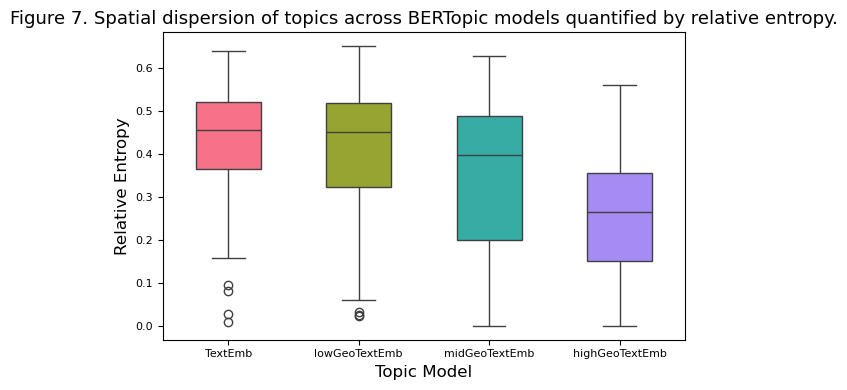

In [21]:
# Define figure size
plt.figure(figsize=(6, 4))

# Define the color palette
palette = sns.color_palette("husl", 4)

# Create the boxplot and capture the axis
ax = sns.boxplot(
    x='Model',
    y='relative_entropy',
    data=entropy_combined,
    palette=palette,
    width=0.5,  # Control box width
    saturation=1
)

# Adjust the edge colors to match the fill colors
for i, patch in enumerate(ax.artists):  # Iterate through the boxes
    patch.set_edgecolor(palette[i])     # Match edge color to fill color
    patch.set_facecolor(palette[i])     # Ensure the fill color is correct
    patch.set_linewidth(1.5)            # Set edge line width
    patch.set_alpha(0.8)                # Adjust transparency (optional)

# Add titles and labels
plt.xlabel('Topic Model', fontsize = 12)
plt.ylabel('Relative Entropy', fontsize = 12)
plt.title('Figure 7. Spatial dispersion of topics across BERTopic models quantified by relative entropy.', fontsize = 13)

# Customize the x-axis labels
custom_labels = ['TextEmb', 'lowGeoTextEmb', 'midGeoTextEmb', 'highGeoTextEmb']
plt.xticks(ticks=range(len(custom_labels)), labels=custom_labels, fontsize = 8)
plt.yticks(fontsize = 8)

# Show the plot with a tight layout
plt.tight_layout()
plt.savefig("RelativeEntropy_Results_Final.jpg", dpi=300, bbox_inches='tight') 
plt.show()

### Kruskal-Wallis Test for Comparing Relative Entropy Distributions


We apply the **Kruskal-Wallis H-test** to statistically evaluate whether the **spatial dispersion distributions** of topics generated by different models are significantly different. The models being compared use different embedding strategies, including text embeddings and geo-text embeddings with varying weights on spatial and textual information.

**Why We Use Kruskal-Wallis:**

- The **spatial entropy** values for each model do not follow a normal distribution, so the **Kruskal-Wallis test** is appropriate as it does not assume normality.
- This test helps us evaluate whether the **geo-text embeddings** significantly affect the **geographic dispersion** of topics. If the test shows significant differences between the models, it suggests that the inclusion of spatial information impacts the spatial entropy distribution.

**Hypotheses:**

- **Null Hypothesis (H₀)**: The median spatial entropy values are the **same across all models**. There are no significant differences in geographic dispersion between the models.
- **Alternative Hypothesis (H₁)**: At least one model has a **different median spatial entropy** compared to the others, indicating that the spatial entropy distributions are not the same.

**Interpreting the Results:**

- The **p-value** obtained from the Kruskal-Wallis test will tell us whether to reject the null hypothesis. A **p-value < 0.05** indicates that the spatial entropy distributions of the models are significantly different.
- If the Kruskal-Wallis test is significant, it suggests that **geo-text embeddings** (in some combination) result in topics with significantly different geographic cdispersion compared to text embeddings alone.


In [22]:
# Extract entropy values for each model to test
entropy_te_ = relative_entropy_te['relative_entropy']
entropy_gte_w2_8_ = relative_entropy_gte0['relative_entropy']
entropy_gte_w3_7_ = relative_entropy_gte1['relative_entropy']
entropy_gte_w4_6_ = relative_entropy_gte2['relative_entropy']

# Kruskal-Wallis H-test to compare all models
stat, p_value = kruskal(entropy_te_, entropy_gte_w2_8_, entropy_gte_w3_7_, entropy_gte_w4_6_)

print(f"Kruskal-Wallis H-test H value: {stat}; p-value: {p_value}")

Kruskal-Wallis H-test H value: 161.33522261537794; p-value: 9.440032369552607e-35


### Dunn's Post-Hoc Test for Pairwise Comparison of Relative Entropy Distributions

After performing the **Kruskal-Wallis H-test**, we found a significant difference in the **spatial dispersion distributions** across the models, indicating that at least one model has a significantly different relative entropy distribution compared to the others. However, the Kruskal-Wallis test only tells us that a difference exists without specifying **which pairs of models** differ.

To further investigate **which specific models** differ in their relative entropy distributions, we perform a **Dunn's post-hoc test** with **Bonferroni correction**. This test allows us to conduct **pairwise comparisons** between the models and identify where significant differences lie.

**Purpose:**

- The Dunn's post-hoc test is applied after a significant Kruskal-Wallis test to compare each pair of models individually.
- By performing this post-hoc analysis, we can identify **which combinations of models** show statistically significant differences in their geographic dispersion (as measured by relative entropy).
- The **Bonferroni correction** is used to adjust for the fact that multiple comparisons are being made, reducing the chance of false positives (Type I errors).

**Hypotheses for Each Pairwise Comparison:**

- **Null Hypothesis (H₀)**: There is **no significant difference** in relative entropy between the two models being compared.
- **Alternative Hypothesis (H₁)**: There is a **significant difference** in relative entropy between the two models being compared.

- Significant results will suggest that one model produces topics with significantly more (or less) geographic cispersion than the other.
</details>

In [23]:
# Combine all entropy values into a list for the post-hoc test
all_entropy_values = [entropy_te_, entropy_gte_w2_8_, entropy_gte_w3_7_, entropy_gte_w4_6_]

# Run Dunn's test with Bonferroni correction
posthoc_result = sp.posthoc_dunn(all_entropy_values, p_adjust='bonferroni')

# Display the pairwise comparison p-values
print(posthoc_result)

              1             2             3             4
1  1.000000e+00  1.000000e+00  9.417348e-05  1.825346e-24
2  1.000000e+00  1.000000e+00  1.759583e-03  9.284954e-24
3  9.417348e-05  1.759583e-03  1.000000e+00  1.105139e-13
4  1.825346e-24  9.284954e-24  1.105139e-13  1.000000e+00


## 5. Explore similarity between the topics models

### Explore top 5 topics for each of the models

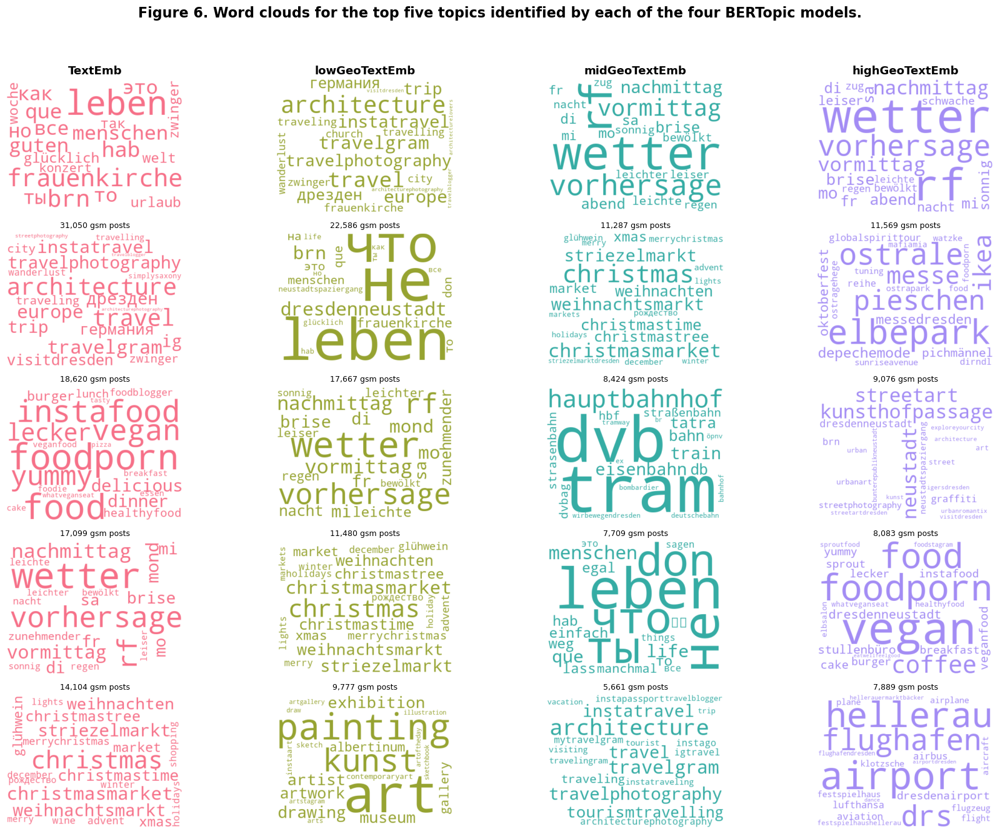

In [24]:
# Define color palette
palette = sns.color_palette("husl", 4)
model_colors = {
    "TextEmb": palette[0],
    "lowGeoTextEmb": palette[1],
    "midGeoTextEmb": palette[2],
    "highGeoTextEmb": palette[3]
}

# Reference models and names
models = {
    "TextEmb": topic_model,
    "lowGeoTextEmb": topic_model0,
    "midGeoTextEmb": topic_model1,
    "highGeoTextEmb": topic_model2
}

# Create figure
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(18, 14))
fig.suptitle("Figure 6. Word clouds for the top five topics identified by each of the four BERTopic models.", fontsize=16, fontweight='bold')

# Loop through models and topics
for col_idx, (model_name, model) in enumerate(models.items()):
    color = model_colors[model_name]
    topic_info = model.get_topic_info().set_index("Topic")

    for row_idx in range(5):
        ax = axes[row_idx, col_idx]
        topic_id = row_idx
        topic_words = model.get_topics().get(topic_id, [])

        if topic_words:
            word_freq = {word: weight for word, weight in topic_words}
            wc = WordCloud(
                width=400,
                height=300,
                background_color='white',
                color_func=lambda *args, **kwargs: tuple(int(c * 255) for c in color)
            ).generate_from_frequencies(word_freq)

            ax.imshow(wc, interpolation='bilinear')
            post_count = topic_info.loc[topic_id, 'Count']
            ax.set_title(f"{post_count:,} gsm posts", fontsize=9)
        else:
            ax.text(0.5, 0.5, 'No Data', ha='center', va='center', fontsize=10)

        ax.axis("off")

    # Set model name as column header
    axes[0, col_idx].set_title(model_name, fontsize=13, fontweight="bold")

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


### Visualize topics related to music

The following visualizations were used to create **Figure 8. Heatmap series illustrating the impact of increased spatial weighting on semantic fragmentation and topic diversity.**


**Note**: Due to the data-sharing restrictions described above, certain parts of this notebook reference CSV input files that are not included in the repository. Consequently, code cells that load or process these files cannot be executed as-is. 

In [25]:
def filter_topic_data(df, topic_col, topic):
    """
    Filters the DataFrame for rows matching the given topic.
    
    Args:
        df (pd.DataFrame): The input DataFrame containing topic data.
        topic_col (str): The column name that holds topic identifiers.
        topic (int or str): The specific topic to filter.
        
    Returns:
        pd.DataFrame: Filtered DataFrame containing only rows for the given topic.
    """
    return df[df[topic_col] == topic]

In [26]:
def create_filtered_topic_heatmap(df, topic_name_col, topic_col,model, topics, layer_name,title, h3_col='h3_index_9'):
    # Create a base map centered at the mean location of the data
    center_lat = df['latitude'].mean()
    center_lon = df['longitude'].mean()
    m = folium.Map(location=[center_lat, center_lon], zoom_start=12, tiles="Cartodb Positron")

    # Add H3 grid cells to the background
    unique_h3_indices = df[h3_col].unique()
    h3_layer = folium.FeatureGroup(name="H3 Grid", show=True)

    for h3_index in unique_h3_indices:
        hex_boundary = h3.h3_to_geo_boundary(h3_index, geo_json=True)
        folium.GeoJson(
            {"type": "Feature", "geometry": {"type": "Polygon", "coordinates": [hex_boundary]}},
            style_function=lambda feature: {
                'fillColor': 'gray',
                'color': 'gray',
                'weight': 1,
                'fillOpacity': 0.1
            }).add_to(h3_layer)

    h3_layer.add_to(m)

    # Function to process topics and add them to the map
    def add_topic_layer(topic_list, category_prefix):
        for topic in topic_list:
            df_filtered = filter_topic_data(df, topic_col, topic)
            if df_filtered.empty:
                continue

            # Get topic name/representation
            topic_repr = df_filtered[topic_name_col].iloc[0]
            topic_repr_clean = topic_repr.replace('[', '').replace(']', '').replace("'", "")
            topic_name = '-'.join(topic_repr_clean.split()[:5]).replace(',', '')

            # Prepare heatmap data directly from latitude and longitude
            heat_data = df_filtered[['latitude', 'longitude']].values.tolist()

            # Create a heatmap layer for each topic
            layer_name = f"{category_prefix} {topic}: {topic_name}"
            heat_layer = folium.FeatureGroup(name=layer_name, show=False)
            HeatMap(heat_data, radius=10, blur=15, max_zoom=1).add_to(heat_layer)
            heat_layer.add_to(m)

    # Add Local Topics
    add_topic_layer(topics, layer_name)

    # Add layer control
    folium.LayerControl(collapsed=False).add_to(m)
    title_html = f'''
    <div style="
        position: fixed; 
        top: 10px; left: 50px; 
        z-index:9999; font-size:14px; font-weight: bold; 
        background-color: rgba(255, 255, 255, 0.7);background-color: rgba(255, 255, 255, 0.7); padding: 5px; border: 1px solid grey;">
       {title} {model} Model
    </div>
'''
    m.get_root().html.add_child(folium.Element(title_html))

    return m


In [27]:
topics_music_TE = [6]
layer = 'Music topics'
title = 'Music related topics for'
# Generate the Map
music_TE = create_filtered_topic_heatmap(df, 'TName_TE', 'T#_TE', 'TextEmb', topics_music_TE, layer, title)
music_TE

In [28]:
topics_music_GTE0 = [11,32,119]
# Generate the Map
music_GTE0 = create_filtered_topic_heatmap(df, 'TName_GTE0', 'T#_GTE0', 'lowGeoTextEmb', topics_music_GTE0, layer,title)
music_GTE0

In [29]:
topics_music_GTE1 = [93,48,44,79,100,183]
# Generate the Map
music_GTE1 = create_filtered_topic_heatmap(df, 'TName_GTE1', 'T#_GTE1', 'midGeoTextEmb', topics_music_GTE1,layer,title)
music_GTE1

In [30]:
topics_music_GTE2 = [14,44,56,163,176,198,266]
# Generate the Map
music_GTE2 = create_filtered_topic_heatmap(df, 'TName_GTE2', 'T#_GTE2', 'highGeoTextEmb', topics_music_GTE2,layer,title)
music_GTE2

### Compare high relative entropy topics for the models


The following visualizations were used to create **Figure 9. Comparison of the most geographically dispersed topics extracted by each model.**

In [31]:
entropy_te = entropy_te.sort_values(by='relative_entropy', ascending = False)
entropy_te.head()

,T#_TE,relative_entropy,Topic,Count,Name,Representation,KeyBERT,Representative_Docs
0,0,0.638165,0,40031,0_leben_frauenkirche_brn_hab,"[leben, frauenkirche, brn, hab, que, то, это, ...","[danke, wünsche, liebe, schön, мне, ты, freita...",NaN
58,58,0.620706,58,990,58_sommer_лето_sommerferien_palaissommer,"[sommer, лето, sommerferien, palaissommer, sch...","[дождливый, дождик, дождем, дождём, regnen, re...",NaN
53,53,0.619097,53,1323,53_nacht_schönen_schöner_wünsche,"[nacht, schönen, schöner, wünsche, evening, to...","[abend, ночного, вечер, evening, ночь, abends,...",NaN
76,76,0.617849,76,528,76_wasser_schwimmen_water_swimming,"[wasser, schwimmen, water, swimming, fountain,...","[qfe, qff, vorhersage, rf, fr, mi, di, wetter,...",NaN
21,21,0.613465,21,3554,21_bike_cycling_outsideisfree_mtb,"[bike, cycling, outsideisfree, mtb, bicycle, b...","[pic, фотография, фото, bild, bildern, foto, ф...",NaN


In [32]:
layer = 'High relative entropy topic'
title = 'High relative entropy topics for'
topics = entropy_te.head(5)['Topic']
# Generate the Map
map_TE = create_filtered_topic_heatmap(df, 'TName_TE', 'T#_TE', 'TextEmb', topics,layer,title)
map_TE

In [33]:
entropy_gte0 = entropy_gte0.sort_values(by='relative_entropy', ascending = False)
entropy_gte0.head()

,T#_GTE0,relative_entropy,Topic,Count,Name,Representation,KeyBERT,Representative_Docs
50,50,0.649797,50,1590,50_sommer_summer_wasser_sommerabend,"[sommer, summer, wasser, sommerabend, sommerli...","[frühstücksliebe, завтрак, frühstück, frühstüc...",NaN
41,41,0.644131,41,1834,41_schönen_thank_nacht_night,"[schönen, thank, nacht, night, thanks, schöner...","[outfitoftheday, styleoftheday, fashiondaily, ...",NaN
141,141,0.628786,141,225,141_arbeit_work_vergnügen_arbeitsweg,"[arbeit, work, vergnügen, arbeitsweg, arbeitsp...","[muttermilchschmuck, молочный, молоком, молока...",NaN
1,1,0.624617,1,22586,1_не_leben_что_dresdenneustadt,"[не, leben, что, dresdenneustadt, brn, frauenk...","[lieben, мне, liebe, leben, меня, sagen, что, ...",NaN
26,26,0.613373,26,2468,26_science_startup_business_entrepreneur,"[science, startup, business, entrepreneur, suc...","[bestfriendgoals, friendstime, friendshipgoals...",NaN


In [34]:
topics = entropy_gte0.head(5)['Topic']
# Generate the Map
map_GTE0 = create_filtered_topic_heatmap(df, 'TName_GTE0', 'T#_GTE0', 'lowGeoTextEmb', topics,layer, title)
map_GTE0

In [35]:
entropy_gte1 = entropy_gte1.sort_values(by='relative_entropy', ascending = False)
entropy_gte1.head()

,T#_GTE1,relative_entropy,Topic,Count,Name,CustomName,Representation,KeyBERT,Representative_Docs
39,39,0.628129,39,1604,39_abend_night_nacht_schönen,Evening & Night,"[abend, night, nacht, schönen, schöner, wünsch...","[cake, birthdaycake, torten, cakestagram, cake...",NaN
97,97,0.625605,97,712,97_thank_спасибо_thanks_за,Gratitude & Appreciation,"[thank, спасибо, thanks, за, tollen, thankyou,...","[instagramapp, iphoneography, instagram, squar...",NaN
56,56,0.622139,56,1258,56_sommer_summer_spring_весна,Summer,"[sommer, summer, spring, весна, schaubudensomm...","[supercars, luxurycars, classiccars, supercar,...",NaN
16,16,0.621109,16,3346,16_wochenende_guten_woche_wünsche,Weekend & Relaxation,"[wochenende, guten, woche, wünsche, schönen, h...","[europetrip, eurotrip, германии, германию, бер...",NaN
3,3,0.620528,3,7709,3_leben_не_ты_что,Life & Thoughts,"[leben, не, ты, что, don, menschen, que, life,...","[travelawesome, travelblog, travelblogger, tra...",NaN


In [36]:
topics = entropy_gte1.head(5)['Topic']
# Generate the Map
map_GTE1 = create_filtered_topic_heatmap(df, 'TName_GTE1', 'T#_GTE1', 'midGeoTextEmb', topics,layer, title)
map_GTE1

In [37]:
entropy_gte2 = entropy_gte2.sort_values(by='relative_entropy', ascending = False)
entropy_gte2.head()

,T#_GTE2,relative_entropy,Topic,Count,Name,Representation,KeyBERT,Representative_Docs
41,41,0.559810,41,1626,41_phonecam_zschonergrund_nature_justlookingar...,"[phonecam, zschonergrund, nature, justlookinga...","[gewandhaushotel, dorinthotel, hotelfrühstück,...",NaN
23,23,0.535241,23,2733,23_renault_leuben_kiesgrube_prohlis,"[renault, leuben, kiesgrube, prohlis, nickern,...","[runnerslife, runnerscommunity, joggen, joggin...",NaN
91,91,0.535144,91,766,91_instagramapp_squareformat_uploaded_iphoneog...,"[instagramapp, squareformat, uploaded, iphoneo...","[путешествияпоевропе, путешествияэтожизнь, ber...",NaN
1,1,0.486469,1,11569,1_elbepark_ostrale_pieschen_ikea,"[elbepark, ostrale, pieschen, ikea, messe, dep...","[dresdenneustadtstyle, dresdenstreetart, stree...",NaN
48,48,0.485267,48,1354,48_yummi_foodporn_instafood_küchenfee,"[yummi, foodporn, instafood, küchenfee, food, ...","[hinternhochundraus, naturguckerde, dresdnerhe...",NaN


In [38]:
topics = entropy_gte2.head(5)['Topic']
# Generate the Map
map_GTE2 = create_filtered_topic_heatmap(df, 'TName_GTE2', 'T#_GTE2', 'highGeoTextEmb', topics,layer, title)
map_GTE2

## 6. Visualize categorized  topics for midGeoTextEmb

We conducted a manual classification of the topics identified by the MidGeoTextEmb model in accordance with the theoretical framework of place semantics, encompassing its three core dimensions: cognitive-affective, socio-cultural, and functional. Topics that did not clearly align with these dimensions—such as those pertaining to weather, fashion, or general social media activity—were grouped into a residual category labeled “other.”

In [41]:
# Load the data
df_topics = pd.read_csv("MidGeoTextEmb_Topics_categorized.csv")

# Ensure no missing values in 'Category' and 'CustomName'
df_topics['Category'] = df_topics['Category'].fillna('other')
df_topics['CustomName'] = df_topics['CustomName'].fillna('unnamed')

# Define lowercase category order and matching colors
ordered_categories = ['cognitive-affective place semantics', 'functional place semantics (affordances)', 'socio-cultural place semantics', 'other']

# Generate seaborn qualitative colors (e.g., from 'deep' palette)
palette = sns.color_palette("Set2", n_colors=4).as_hex()

# Map colors to ordered categories
color_keys = ordered_categories  # since it's already a list
color_map = {cat: col for cat, col in zip(color_keys, palette)}

# Set category order for sorting
df_topics['Category'] = pd.Categorical(df_topics['Category'], categories=ordered_categories, ordered=False)
df_topics = df_topics.sort_values('Category')

# Create treemap
fig = px.treemap(
    df_topics,
    path=['Category', 'CustomName'],
    values='Count',
    color='Category',
    color_discrete_map=color_map
)
fig.update_layout(
    title={
        'text': "Figure 10. midGeoTextEmb topics categorized into three dimensions of place semantics",
        'y': 0.95,  # Position vertically (0 to 1)
        'x': 0.5,   # Center horizontally
        'xanchor': 'center',
        'yanchor': 'top'
    },
    font=dict(
        family="Arial",
        size=18,
        color="black"
    ),
    margin=dict(t=50, l=25, r=25, b=25)
)
fig.show(renderer='iframe')


In [2]:
!jupyter nbconvert --to html "Evaluation.ipynb" --output "Evaluation.html"

[NbConvertApp] Converting notebook Evaluation.ipynb to html
[NbConvertApp] Writing 29033818 bytes to Evaluation.html
